In [1]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")
import time
import pickle
from matplotlib import animation

# cells defined in earlier notebooks

In [2]:
"""
parameters from Zaytsev 2016
"""

kcis = 7.29*10**-6    # 1/s        # rate constant for 'in cis' Aurora B activation

kfa  = 0.1            # 1/(uM*s)   # rate constant for AA complex formation
kca  = 2.7*10**-2     # 1/s        # rate constant for AA catalysis
Kma  = 51             # uM         # Michaelis constant for AA 'in trans' activation
kra  = kfa*Kma-kca    # 1/         # rate constant for AA complex dissociation

kfp  = 0.6            # 1/(uM*s)   # rate constant for PhA complex formation
kcp  = 2.4*10**-2     # 1/s        # rate constant for PhA catalysis
Kmp  = 1.95           # uM         # Michaelis constant for PhA 'in trans' activation
krp  = kfp*Kmp-kcp    # 1/s        # rate constant for PhA complex dissociation

In [3]:
def saddle_node_locator(ss_list):
    """
    find point where steady state (ss) jumps (hysteresis)
    where unsteady state manifold appears/disappears
    """
    for n,(i,j) in enumerate(zip(ss_list[:-1], ss_list[1:])):
        if abs(j-i) > 0.3:
            return n+1

In [4]:
def mesh_fourier(zmin,zmax,nz):
    """
    discrete approximation of the spatial derivative operator (Laplacian)
    uses spectral symmetry to simplify operations, forces periodic boundary conditions
    """
    dz = np.zeros((nz,nz))
    for i in range(nz):
        for j in range(nz):
            if i == j:
                dz[i,i] = 0
            else:
                dz[i,j] = np.pi*(-1)**((i-1)+(j-1))/(zmax-zmin)/np.tan(((i-1)-(j-1))*np.pi/(nz))
    return dz

In [5]:
def find_nearest(array, value):
    """
    returns location of point nearest to input value within input array
    """
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx], idx

In [6]:
def R_binding(y):
    """
    system of ODEs from Zaytsev 2016 where kinase binding to sites along a chromosome is included,
    previously defined a/A/aA/PhA components involve a diffusible/unbound Aurora B kinase,
    the following components are introduced in this model:
    - b: inactive/bound Aurora B kinase
    - B: active/bound Aurora B kinase
    - aB/bA/bB: enzyme-substrate complexes of inactive/active/bound/diffusible Aurora B kinase
    - PhB: enzyme-substrate complex of phosphatase + active/bound Aurora B kinase
    - BS: free binding sites
    """
    A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS = y

    dAdt = (kcis - kfa*A)*a + (kra + 2*kca)*aA - kfp*A*Ph + krp*PhA +\
        kca*aB - kfa*A*b + (kra + kca)*bA + koff*B - kon*BS*A
    
    dBdt = (kcis - kfb*B)*b + (krb + 2*kca)*bB - kfp*B*Ph + krp*PhB +\
        kca*bA - kfa*B*a + (kra + kca)*aB - koff*B + kon*BS*A
    
    dadt = -(kcis + kfa*A + kfa*B)*a + kra*(aA + aB) + kcp*PhA + koff*b - kon*BS*a
    dbdt = -(kcis + kfb*B + kfa*A)*b + krb*bB + kra*bA + kcp*PhB - koff*b + kon*BS*a
    
    daAdt = kfa*a*A - (kra + kca)*aA
    daBdt = kfa*a*B - (kra + kca)*aB
    dbAdt = kfa*b*A - (kra + kca)*bA
    dbBdt = kfb*b*B - (krb + kca)*bB
    
    dPhdt = -kfp*Ph*(A + B) + (krp + kcp)*(PhA + PhB)
    dPhAdt = kfp*Ph*A - (krp + kcp)*PhA
    dPhBdt = kfp*Ph*B - (krp + kcp)*PhB
    
    return dAdt, dBdt, dadt, dbdt, daAdt, daBdt, dbAdt, dbBdt, dPhdt, dPhAdt, dPhBdt

In [7]:
def spatial_simulation_binding(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw):
    """
    reaction-diffusion algorithm with added binding/localization reactions
    available chromosomal binding sites are situated in a Gaussian-like distribution
    initial kinase/phosphatase conditions are constant across domain
    """
    A = np.zeros(N) + A0
    B = np.zeros(N)
    a = np.zeros(N) + Atot - A
    b = np.zeros(N)
    aA = np.zeros(N)
    aB = np.zeros(N)
    bA = np.zeros(N)
    bB = np.zeros(N)
    Ph = np.zeros(N) + P0
    PhA = np.zeros(N)
    PhB = np.zeros(N)
    
    x = np.linspace(-L/2, L/2, N)
    
    BS0 = (Atot - BSmin) * np.exp(- Atot / BSw * x**2) + BSmin
    
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS0
    
    A_arr = np.zeros((N,round(t_end/t_save)+1))
    B_arr = np.zeros((N,round(t_end/t_save)+1))
    a_arr = np.zeros((N,round(t_end/t_save)+1))
    b_arr = np.zeros((N,round(t_end/t_save)+1))
    aA_arr = np.zeros((N,round(t_end/t_save)+1))
    aB_arr = np.zeros((N,round(t_end/t_save)+1))
    bA_arr = np.zeros((N,round(t_end/t_save)+1))
    bB_arr = np.zeros((N,round(t_end/t_save)+1))
    Ph_arr = np.zeros((N,round(t_end/t_save)+1))
    PhA_arr = np.zeros((N,round(t_end/t_save)+1))
    PhB_arr = np.zeros((N,round(t_end/t_save)+1))
    BS_arr = np.zeros((N,round(t_end/t_save)+1))
    t_vec = np.zeros(round(t_end/t_save)+1)
    
    A_arr[:,0] = A
    a_arr[:,0] = a
    Ph_arr[:,0] = Ph
    BS_arr[:,0] = BS0
    
    dz = mesh_fourier(0,L,N)
    dz2 = np.dot(dz,dz)
    
    counter = -1
    counter_save = 0
    t = 0
    
    for i in range(round(t_end/dt)+1):
        counter += 1
        
        dy = R_binding(y)
        
        A += dt*(dy[0] + D*np.dot(dz2,A))
        B += dt*dy[1]
        a += dt*(dy[2] + D*np.dot(dz2,a))
        b += dt*dy[3]
        aA += dt*(dy[4] + D*np.dot(dz2,aA))
        aB += dt*dy[5]
        bA += dt*dy[6]
        bB += dt*dy[7]
        Ph += dt*(dy[8] + D*np.dot(dz2,Ph))
        PhA += dt*(dy[9] + D*np.dot(dz2,PhA))
        PhB += dt*dy[10]
        
        BS = BS0 - B - b - aB - bA - 2*bB - PhB
        
        y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
        
        t += dt
        
        if counter == round(t_save/dt):
            counter = 0
            counter_save += 1
            
            A_arr[:,counter_save] = A
            B_arr[:,counter_save] = B
            a_arr[:,counter_save] = a
            b_arr[:,counter_save] = b
            aA_arr[:,counter_save] = aA
            aB_arr[:,counter_save] = aB
            bA_arr[:,counter_save] = bA
            bB_arr[:,counter_save] = bB
            Ph_arr[:,counter_save] = Ph
            PhA_arr[:,counter_save] = PhA
            PhB_arr[:,counter_save] = PhB
            BS_arr[:,counter_save] = BS
            t_vec[counter_save] = t
    
    arrays = A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
    
    return arrays, y

In [8]:
"""
additional parameters for the binding model 
previously defined parameters for the nonbinding model still apply
"""

# sterically limited b*B in trans autoactivation
kfb   = kfa * 0.01      # 1/(uM*s)
Kmb   = Kma * 100       # uM
kra   = kfa*Kma-kca     # 1/s
krb   = kfb*Kma-kca     # 1/s

# rate constants for kinase binding + dissociating from binding sites
kon = 2.9                # 1/(uM*s)
koff = 0.014             # 1/s

# kinase/PPase dynamics in the mass-action model

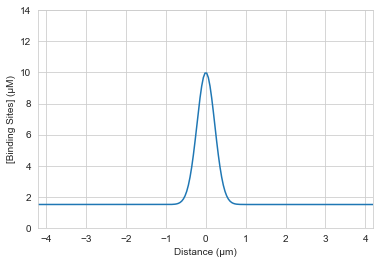

In [9]:
"""
constructs/plots kinase chromosomal binding site profile to be used for simulations below
"""

N = 480
L = 20
x_span = np.linspace(-L/2,L/2,N)

# narrows initial binding site profile relative to Figure 15 (smaller BSw)
Atot = 10
BSmin = 1.5
BSw = 1

BS0 = (Atot-BSmin) * np.exp(- Atot / BSw * x_span**2) + BSmin

plt.plot(x_span,BS0)
plt.ylim(0,14)
plt.xlim(-4.2,4.2)
plt.ylabel('[Binding Sites] (\u03BCM)')
plt.xlabel('Distance (\u03BCm)');

In [10]:
"""
parameters for simulation below
"""
t_end = 2000*60
dt = 0.035
t_save = 60

A0 = 0
P0 = 0.55

D = 10**-5

In [122]:
"""
simulates reaction/diffusion/localization with 0.55 uM phosphatase + 10e-5 diffusion coefficient
total kinase kept at 10 uM across domain length, initial active kinase at zero
using the binding site profile plotted above
"""
start = time.time()
## algorithm takes ~34 min

bindingsim_P055_dynamic, y = spatial_simulation_binding(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw)

pickle.dump(bindingsim_P055_dynamic,open('bindingsim_P055_dynamic','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 34.4 min


In [11]:
"""
sums matrix slices to compose time or space profiles of active kinase, total kinase, and phosphatase
where time profiles are spatially specific and extend through time
and space profiles are temporally specific and extend throughout the spatial domain
while the other functions return spatially/temporally specific points
"""

def ABKp_space_profile(t):
    return A_arr[:,t]+B_arr[:,t]
def ABKp_time_profile(x):
    return A_arr[x,:]+B_arr[x,:]
def ABKp_pt(x,t):
    return A_arr[x,t]+B_arr[x,t]

def totalABK_space_profile(t):
    kinase = A_arr[:,t]+B_arr[:,t]+\
        a_arr[:,t]+b_arr[:,t]+\
        2*aA_arr[:,t]+2*aB_arr[:,t]+\
        2*bA_arr[:,t]+2*bB_arr[:,t]+\
        PhA_arr[:,t]+PhB_arr[:,t]
    return kinase
def totalABK_time_profile(x):
    kinase = A_arr[x,:]+B_arr[x,:]+\
        a_arr[x,:]+b_arr[x,:]+\
        2*aA_arr[x,:]+2*aB_arr[x,:]+\
        2*bA_arr[x,:]+2*bB_arr[x,:]+\
        PhA_arr[x,:]+PhB_arr[x,:]
    return kinase
def totalABK_pt(x,t):
    kinase = A_arr[x,t]+B_arr[x,t]+a_arr[x,t]+b_arr[x,t]+\
        2*aA_arr[x,t]+2*aB_arr[x,t]+2*bA_arr[x,t]+2*bB_arr[x,t]+\
        PhA_arr[x,t]+PhB_arr[x,t]
    return kinase

def PPase_space_profile(t):
    return Ph_arr[:,t]+PhA_arr[:,t]+PhB_arr[:,t]
def PPase_time_profile(x):
    return Ph_arr[x,:]+PhA_arr[x,:]+PhB_arr[x,:]
def PPase_pt(x,t):
    return Ph_arr[x,t]+PhA_arr[x,t]+PhB_arr[x,t]

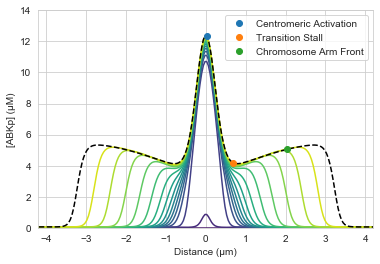

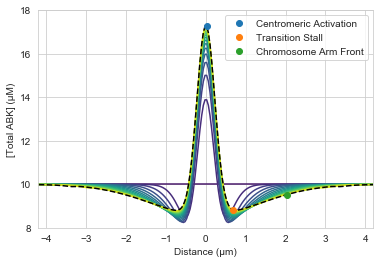

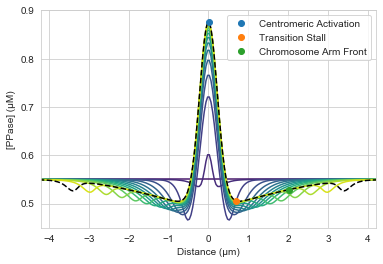

In [12]:
"""
Figure 21A
plots simulation results with a 100 min separation between each spatial profile
- time evolution of spatial profiles of active kinase, total kinase, and phosphatase
- three points indicate different behavioral regions:
    - centromeric activation : where localized kinase autoactivates
    - transition stall : region of slow propagation between centromere / chromosome arms
    - chromosome arm front : linearly propagating traveling front outward
"""

bindingsim_P055_dynamic = pickle.load(open('bindingsim_P055_dynamic','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic

end = 1500
lin_range = range(0,end,100)
colors = sns.color_palette('viridis', n_colors=len(lin_range))

# plots active kinase profiles
for n,i in enumerate(lin_range):
    plt.plot(x_span, ABKp_space_profile(i), color=colors[n])
plt.plot(x_span, ABKp_space_profile(end), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,14)
plt.xlim(-4.2,4.2)

# three points representative of the different behavioral regions
x_slices = [60*4, 64*4, 72*4]
slice_colors = ['C0o','C1o','C2o']
labels = ['Centromeric Activation','Transition Stall', 'Chromosome Arm Front']

# plots three points along ending active kinase profile
for x,slice_color,label in zip(x_slices,slice_colors,labels):
    plt.plot(x_span[x], ABKp_pt(x,end), slice_color, label=label)
plt.legend()
plt.show()

# plots total kinase profiles
for n,i in enumerate(lin_range):
    plt.plot(x_span, totalABK_space_profile(i), color=colors[n])
plt.plot(x_span, totalABK_space_profile(end), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[Total ABK] (\u03BCM)")
plt.ylim(8,18)
plt.xlim(-4.2,4.2)

# plots three points along ending total kinase profile
for x,slice_color,label in zip(x_slices,slice_colors,labels):
    plt.plot(x_span[x], totalABK_pt(x,end), slice_color, label=label)
plt.legend()
plt.show()

# plots phosphatase profiles
for n,i in enumerate(lin_range):
    plt.plot(x_span, PPase_space_profile(i), color=colors[n])
plt.plot(x_span, PPase_space_profile(end), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[PPase] (\u03BCM)")
plt.ylim(.45,.9)
plt.locator_params(axis='y', nbins=5)
plt.xlim(-4.2,4.2)

# plots three points along ending phosphatase profile
for x,slice_color,label in zip(x_slices,slice_colors,labels):
    plt.plot(x_span[x], PPase_pt(x,end), slice_color, label=label)
plt.legend();

In [13]:
"""
algorithm to pull the times/active kinase values of each discretized x_slice (blue/orange/green pts)
at four intervals proportional to the respective low/high steady states
similar as for the phenomenological model discretization in Figure 17C (notebook 6.5)
"""

def discretize_into_slices(x_slices):
    t_of_xslices = []
    ABKp_of_xslices = []
    totalABK_of_xslices = []
    PPase_of_xslices = []

    for x_slice in x_slices:

        # lo/hi = initial/final values (diffusible + bound kinase) for each x_slice
        lo = ABKp_pt(x_slice,0)
        hi = ABKp_pt(x_slice,-1)

        # start each list with initial values
        t_of_xslice = [0]
        ABKp_of_xslice = [lo]
        totalABK_of_xslice = [totalABK_pt(x_slice,0)]
        PPase_of_xslice = [PPase_pt(x_slice,0)]

        # 3 intermediate + 1 approximate final level
        intervals = [.2, .5, .8, .99]
        for interval in intervals:

            # calculate interval position, find nearest point, extract active kinase + time
            ABKp, t = find_nearest( ABKp_time_profile(x_slice), interval*(hi-lo)+lo )
            ABKp_of_xslice.append(ABKp)
            t_of_xslice.append(t/60)

            # use this time to extract total kinase + phosphatase
            totalABK_of_xslice.append( totalABK_pt(x_slice,t) )
            PPase_of_xslice.append( PPase_pt(x_slice,t) )

        t_of_xslices.append(t_of_xslice)
        ABKp_of_xslices.append(ABKp_of_xslice)
        totalABK_of_xslices.append(totalABK_of_xslice)
        PPase_of_xslices.append(PPase_of_xslice)
        
    return t_of_xslices, ABKp_of_xslices, totalABK_of_xslices, PPase_of_xslices

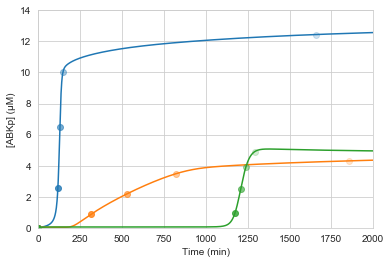

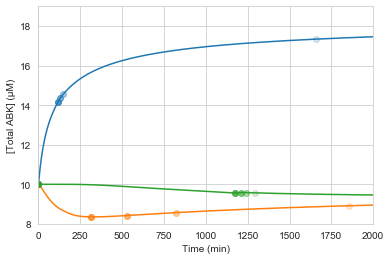

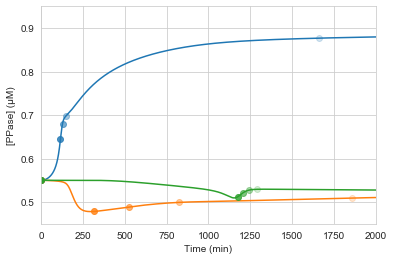

In [14]:
"""
Figure 21B/C/D
plots active kinase / total kinase / PPase curves (diffusible + bound) with time of the three x_slices
plus points indicating 4 intervals in respect to low/high steady states
- centromeric activation preceded by an increase in local total kinase, PPase during autoactivation
    - localization force pulls in surrounding kinase
    - autoactivation pulls in PPase
- transition stall marked by decreases in local total kinase + PPase
    - localization force pulls kinase away from the centromeric-proximal regions
    - autoactivation pulls PPase away
- chromosomal arm front preceded by a decrease in local PPase
    - far enough to be unaffected by localization
    - activation of oncoming traveling front pulls PPase away
"""

t_of_xslices, ABKp_of_xslices, totalABK_of_xslices, PPase_of_xslices = discretize_into_slices(x_slices)

t = np.arange(0, t_end+.1, t_save)
# plots active kinase curve with respect to time for each x_slice
for x_slice in x_slices:
    plt.plot(t/60, ABKp_time_profile(x_slice))

# groups each x_slice with corresponding t/Ap vectors and colors
colors = ['C0o','C1o','C2o']
for x_slice,ts,ABKps,color in zip(x_slices, t_of_xslices, ABKp_of_xslices, colors):
    
    # plots each t/Ap with decreasing transparency
    alphas = [1,.8,.6,.4,.2]
    for t_,ABKp_,alp in zip(ts, ABKps, alphas):
        plt.plot(t_*t_save, ABKp_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(0,14)
plt.ylabel('[ABKp] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# total kinase trajectories + interval points
for x_slice in x_slices:
    plt.plot(t/60, totalABK_time_profile(x_slice))

for x_slice,ts,totalABKs,color in zip(x_slices, t_of_xslices, totalABK_of_xslices, colors):
    
    for t_,totalABK_,alp in zip(ts, totalABKs, alphas):
        plt.plot(t_*t_save, totalABK_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(8,19)
plt.ylabel('[Total ABK] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# phosphatase trajectories + interval points
for x_slice in x_slices:
    plt.plot(t/60, PPase_time_profile(x_slice))

for x_slice,ts,PPases,color in zip(x_slices, t_of_xslices, PPase_of_xslices, colors):
    
    for t_,PPase_,alp in zip(ts, PPases, alphas):
        plt.plot(t_*t_save, PPase_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(.45,.95)
plt.ylabel('[PPase] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

In [17]:
"""
Supplemental Movie 2 (a)
compiles animation for kinase activation + movement in space
uses the mass-action model, plots profiles every 10 min
"""

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-4.2,4.2), ylim=(-0.5, 14.5))

ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[ABKp] (\u03BCM)')

line, = ax.plot([], [], 'k')
dot0, = ax.plot([], [], 'C0o')
dot1, = ax.plot([], [], 'C1o')
dot2, = ax.plot([], [], 'C2o')
dots = [dot0,dot1,dot2]

interval = 10

def animate(i):
    
    line.set_data(x_span, ABKp_space_profile(i*interval))
    
    for dot,x_slice,label in zip(dots,x_slices,labels):
        dot.set_data(x_span[x_slice], ABKp_pt(x_slice, i*interval))
        dot.set_label(label)
    
    ax.legend()
    
    return line,

plt.close()
plt.rcParams["animation.html"] = "jshtml"
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)

In [19]:
"""
Supplemental Movie 2 (b)
compiles animation for total kinase movement (localization to centromere) in space
uses the mass-action model, plots profiles every 10 min
"""

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-4.2,4.2), ylim=(8, 18))

ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[Total ABK] (\u03BCM)')

line, = ax.plot([], [], 'k')
dot0, = ax.plot([], [], 'C0o')
dot1, = ax.plot([], [], 'C1o')
dot2, = ax.plot([], [], 'C2o')
dots = [dot0,dot1,dot2]

interval = 10

def animate(i):
    
    line.set_data(x_span, totalABK_space_profile(i*interval))
    
    for dot,x_slice,label in zip(dots,x_slices,labels):
        dot.set_data(x_span[x_slice], totalABK_pt(x_slice, i*interval))
        dot.set_label(label)
    
    ax.legend()
    
    return line,

plt.close()
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)

In [20]:
"""
Supplemental Movie 2 (c)
compiles animation for phosphatase movement (attraction to active kinase) in space
uses the mass-action model, plots profiles every 10 min
"""

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-4.2,4.2), ylim=(.45, .9))
ax.locator_params(axis='y', nbins=5)

ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[PPase] (\u03BCM)')

line, = ax.plot([], [], 'k')
dot0, = ax.plot([], [], 'C0o')
dot1, = ax.plot([], [], 'C1o')
dot2, = ax.plot([], [], 'C2o')
dots = [dot0,dot1,dot2]

interval = 10

def animate(i):
    
    line.set_data(x_span, PPase_space_profile(i*interval))
    
    for dot,x_slice,label in zip(dots,x_slices,labels):
        dot.set_data(x_span[x_slice], PPase_pt(x_slice, i*interval))
        dot.set_label(label)
    
    ax.legend()
    
    return line,

plt.close()
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)

In [21]:
def bistability_curve(P):
    """
    algorithm builds bistability curve with varying total kinase
    """
    BS = 0
    tspan = np.linspace(0,5000*60,10000)

    Atot_range = np.arange(0,18,.05)
    lo_list = []
    hi_list = []
    Atot_bistable_list = []
    bistable_list = []

    for Atot in Atot_range:

        lo_init = [0,0,Atot,0,0,0,0,0,P,0,0,BS]
        y = odeint(R_binding_odeint,lo_init,tspan)
        lo_ss = y[-1,0]+y[-1,1]
        lo_list.append(lo_ss)

        hi_init = [Atot,0,0,0,0,0,0,0,P,0,0,BS]
        y = odeint(R_binding_odeint,hi_init,tspan)
        hi_ss = y[-1,0]+y[-1,1]
        hi_list.append(hi_ss)

        if not np.isclose(lo_ss, hi_ss, atol=1):
            Atot_bistable_list.append(Atot)
            bistable_list.append((Atot, lo_ss, hi_ss))

    unstablemanifold_list = []
    for Atot, lo_ss, hi_ss in bistable_list:
        A0 = lo_ss
        y_sim = np.zeros((2,2))
        y_sim[-1,0] = y_sim[-1,1] = -1
        while y_sim[-1,0]+y_sim[-1,1] < np.average((A0,lo_ss)):
            A0 += .01
            A_init = [A0,0,Atot-A0,0,0,0,0,0,P,0,0,BS]
            y_sim = odeint(R_binding_odeint,A_init,tspan)
        unstablemanifold_list.append(A0)

    n_lo = saddle_node_locator(lo_list)
    n_hi = saddle_node_locator(hi_list)

    saddle_x = [Atot_range[n_hi]] + Atot_bistable_list + [Atot_range[n_lo-1]]
    saddle_y = [hi_list[n_hi]] + unstablemanifold_list + [lo_list[n_lo-1]]

    return Atot_range,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y

In [22]:
def R_binding_odeint(y,t):
    """
    same as R_binding but calling both y,t as input variables, necessary to use with odeint()
    """
    A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS = y

    dAdt = (kcis - kfa*A)*a + (kra + 2*kca)*aA - kfp*A*Ph + krp*PhA +\
        kca*aB - kfa*A*b + (kra + kca)*bA + koff*B - kon*BS*A
    
    dBdt = (kcis - kfb*B)*b + (krb + 2*kca)*bB - kfp*B*Ph + krp*PhB +\
        kca*bA - kfa*B*a + (kra + kca)*aB - koff*B + kon*BS*A
    
    dadt = -(kcis + kfa*A + kfa*B)*a + kra*(aA + aB) + kcp*PhA + koff*b - kon*BS*a
    dbdt = -(kcis + kfb*B + kfa*A)*b + krb*bB + kra*bA + kcp*PhB - koff*b + kon*BS*a
    
    daAdt = kfa*a*A - (kra + kca)*aA
    daBdt = kfa*a*B - (kra + kca)*aB
    dbAdt = kfa*b*A - (kra + kca)*bA
    dbBdt = kfb*b*B - (krb + kca)*bB
    
    dPhdt = -kfp*Ph*(A + B) + (krp + kcp)*(PhA + PhB)
    dPhAdt = kfp*Ph*A - (krp + kcp)*PhA
    dPhBdt = kfp*Ph*B - (krp + kcp)*PhB
    dBSdt = koff*(b + B) - kon*BS*(a + A)
    
    return dAdt, dBdt, dadt, dbdt, daAdt, daBdt, dbAdt, dbBdt, dPhdt, dPhAdt, dPhBdt, dBSdt

In [ ]:
"""
constructs bistability curves for the PPase values associated with each point in time for each region
to be used to construct animations below to show the change in the bistability curve 
with respect to the changing local active kinase, total kinase, phosphatase concentrations
"""
start = time.time()
## algorithm takes >24 hrs

bistab_curves_by_xslice = []
for x_slice in x_slices:
    
    print(f'x_slice: {x_slice}')
    
    PP_by_time = PPase_time_profile(x_slice)[:1501:10]
    P0 = PP_by_time[0]
    
    print(f'P: {round(P0,5)}')
    Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y = bistability_curve(P0)
    bistab_curves = [(P0,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y)]
    
    for i in range(1,len(PP_by_time)):
        
        P = PP_by_time[i]
        print(f'P: {round(P,5)}')
        
        diff = abs(P - P0)
        
        if diff > 0.0002:
            Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y = bistability_curve(P)
            bistab_curves.append((P,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y))
            P0 = PP_by_time[i]
        else:
            bistab_curves.append((P,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y))
        
    bistab_curves_by_xslice.append((x_slice,bistab_curves))

pickle.dump(bistab_curves_by_xslice,open('bistab_curves_by_xslice','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min \n')

In [23]:
"""
Supplemental Movie 2 (d)
compiles animation for bistability curve dynamics (changing phosphatase concentration)
uses the mass-action model, plots profiles every 10 min
specific to a spatial slice representative of kinase autoactivation in the centromere
plots the total kinase + active kinase in the phase plane with respect to the bistabilty curve

- increasing total kinase due to centromeric localization moves the system to the right,
from the bistable region to the monostable high branch, allowing autoactivation upwards
- increasing phosphatase following autoactivation pushes the bistable curve rightwards
"""
bistab_curves_by_xslice = pickle.load(open('bistab_curves_by_xslice','rb'))

plot_data_list = [
    ('C0','C0:','Centromeric Activation'),
    ('C1','C1:','Transition Stall'),
    ('C2','C2:','Chromosome Arm Front')
]

x_slice,bistab_curves = bistab_curves_by_xslice[0]
color_solid,color_dotted,label = plot_data_list[0]

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-0.5, 18), ylim=(-0.5, 14.5))

ax.set_xlabel('[Total ABK] (\u03BCM)')
ax.set_ylabel('[ABKp] (\u03BCM)')

upper_line, = ax.plot([], [], color_solid)
lower_line, = ax.plot([], [], color_solid)
dot_line, = ax.plot([], [], color_dotted)
dot, = ax.plot([], [], 'ko')

# Define animate function
def animate(i):

    P,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y = bistab_curves[i]
    upper_line.set_data(Atot_list[:n_lo], lo_list[:n_lo])
    lower_line.set_data(Atot_list[n_hi:], hi_list[n_hi:])
    dot_line.set_data(saddle_x,saddle_y)
    dot.set_data(totalABK_time_profile(x_slice)[::10][i],ABKp_time_profile(x_slice)[::10][i])
    upper_line.set_label(label)
    ax.legend(loc='upper left')

    return upper_line,lower_line,dot_line,dot

plt.close()
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)

In [24]:
"""
Supplemental Movie 2 (e)
compiles animation for bistability curve dynamics (changing phosphatase concentration)
uses the mass-action model, plots profiles every 10 min
specific to a spatial slice representative of the front stall in the transition region
plots the total kinase + active kinase in the phase plane with respect to the bistabilty curve

- decreasing total kinase due to centromeric localization moves the system left,
towards the monostable low branch, staying inactivating temporarily
- decreasing phosphatase following autoactivation pushes the bistable curve leftwards,
pulling the system back to bistability + with a high threshold, 
allowing slow activation as nearby active kinase diffuses from the centromere
"""

x_slice,bistab_curves = bistab_curves_by_xslice[1]
color_solid,color_dotted,label = plot_data_list[1]

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-0.5, 18), ylim=(-0.5, 14.5))

ax.set_xlabel('[Total ABK] (\u03BCM)')
ax.set_ylabel('[ABKp] (\u03BCM)')

upper_line, = ax.plot([], [], color_solid)
lower_line, = ax.plot([], [], color_solid)
dot_line, = ax.plot([], [], color_dotted)
dot, = ax.plot([], [], 'ko')

def animate(i):

    P,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y = bistab_curves[i]
    upper_line.set_data(Atot_list[:n_lo], lo_list[:n_lo])
    lower_line.set_data(Atot_list[n_hi:], hi_list[n_hi:])
    dot_line.set_data(saddle_x,saddle_y)
    dot.set_data(totalABK_time_profile(x_slice)[::10][i],ABKp_time_profile(x_slice)[::10][i])
    upper_line.set_label(label)
    ax.legend(loc='upper left')

    return upper_line,lower_line,dot_line,dot

plt.close()
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)

In [25]:
"""
Supplemental Movie 2 (f)
compiles animation for bistability curve dynamics (changing phosphatase concentration)
uses the mass-action model, plots profiles every 10 min
specific to a spatial slice representative of the traveling wave along a chromosome arm
plots the total kinase + active kinase in the phase plane with respect to the bistabilty curve

- total kinase does not shift the system far to the left/right
- decreasing phosphatase towards the oncoming traveling front 
slightly pushes the bistability curve left, lowering the threshold for quick activation,
realigning as other PPase fills its place
"""

x_slice,bistab_curves = bistab_curves_by_xslice[2]
color_solid,color_dotted,label = plot_data_list[2]

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
ax.set(xlim=(-0.5, 18), ylim=(-0.5, 14.5))

ax.set_xlabel('[Total ABK] (\u03BCM)')
ax.set_ylabel('[ABKp] (\u03BCM)')

upper_line, = ax.plot([], [], color_solid)
lower_line, = ax.plot([], [], color_solid)
dot_line, = ax.plot([], [], color_dotted)
dot, = ax.plot([], [], 'ko')

def animate(i):

    P,Atot_list,lo_list,n_lo,hi_list,n_hi,saddle_x,saddle_y = bistab_curves[i]
    upper_line.set_data(Atot_list[:n_lo], lo_list[:n_lo])
    lower_line.set_data(Atot_list[n_hi:], hi_list[n_hi:])
    dot_line.set_data(saddle_x,saddle_y)
    dot.set_data(totalABK_time_profile(x_slice)[::10][i],ABKp_time_profile(x_slice)[::10][i])
    upper_line.set_label(label)
    ax.legend(loc='upper left')

    return upper_line,lower_line,dot_line,dot

plt.close()
animation.FuncAnimation(fig, animate, frames=150, interval=20, blit=True)